In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from mpl_toolkits.mplot3d import Axes3D

# 1. 전역 설정: Azure Kinect 스켈레톤 연결 구조
SKELETON_LINES = [
    (0, 1), (1, 2), (2, 3), (3, 26), (26, 27), 
    (27, 28), (27, 30), (27, 29), (27, 31),
    (2, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9), (7, 10),
    (2, 11), (11, 12), (12, 13), (13, 14), (14, 15), (15, 16), (14, 17),
    (0, 18), (18, 19), (19, 20), (20, 21),
    (0, 22), (22, 23), (23, 24), (24, 25)
]

FILE_PATH = './Assets/JointCSV/Joint_Stand_P01.csv' 
df = pd.read_csv(FILE_PATH)

# 모든 관절 컬럼 리스트 생성
coord_cols = [f'P{i}_{axis}' for i in range(32) for axis in ['posX', 'posY', 'posZ']]

# [수정] IsDetected 대신, P0 관절의 X값이 0이 아닌 유효한 데이터만 추출
# (감지되지 않았을 때 좌표가 0으로 기록되는 특성을 이용)
df_clean = df[df['P0_posX'] != 0].dropna(subset=coord_cols).reset_index(drop=True)

print(f"데이터 로드 및 정제 완료: 총 {len(df_clean)}개의 유효 프레임이 있습니다.")

데이터 로드 및 정제 완료: 총 462개의 유효 프레임이 있습니다.


### Frame Image

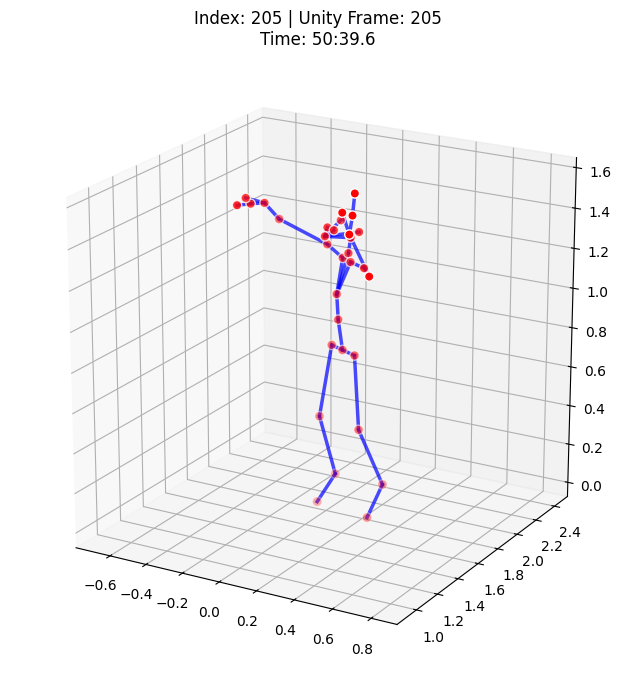

In [16]:
def show_frame(index):
    if index >= len(df_clean):
        print(f"인덱스 범위를 벗어났습니다. (최대 인덱스: {len(df_clean)-1})")
        return
        
    row = df_clean.iloc[index]
    coords = np.array([[row[f'P{i}_posX'], row[f'P{i}_posY'], row[f'P{i}_posZ']] for i in range(32)])

    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')

    # 점과 선 그리기 (Unity Y-up 보정: Plot X, Z, Y)
    ax.scatter(coords[:, 0], coords[:, 2], coords[:, 1], c='red', s=45, edgecolors='white')
    for line in SKELETON_LINES:
        p1, p2 = coords[line[0]], coords[line[1]]
        ax.plot([p1[0], p2[0]], [p1[2], p2[2]], [p1[1], p2[1]], c='blue', linewidth=2.5, alpha=0.7)

    # 설정
    ax.set_box_aspect((1, 1, 1))
    ax.view_init(elev=20, azim=-60)
    ax.set_title(f"Index: {index} | Unity Frame: {int(row['Frame'])}\nTime: {row['Timestamp']}")
    
    # 범위 자동 설정
    max_range = (coords.max(axis=0) - coords.min(axis=0)).max() / 2.0
    mid = (coords.max(axis=0) + coords.min(axis=0)) * 0.5
    ax.set_xlim(mid[0] - max_range, mid[0] + max_range)
    ax.set_ylim(mid[2] - max_range, mid[2] + max_range)
    ax.set_zlim(mid[1] - max_range, mid[1] + max_range)

    plt.show()

# 예시 실행
show_frame(205)

### GIF

In [12]:
fig_anim = plt.figure(figsize=(8, 8))
ax_anim = fig_anim.add_subplot(111, projection='3d')

# 전체 데이터 범위 미리 계산 (화면 흔들림 방지)
all_coords = df_clean[coord_cols].values.reshape(-1, 32, 3)
min_vals = all_coords.min(axis=(0, 1))
max_vals = all_coords.max(axis=(0, 1))
mid_global = (max_vals + min_vals) * 0.5
range_global = (max_vals - min_vals).max() / 2.0 + 0.1

def update_anim(frame):
    ax_anim.clear()
    row = df_clean.iloc[frame]
    coords = np.array([[row[f'P{i}_posX'], row[f'P{i}_posY'], row[f'P{i}_posZ']] for i in range(32)])
    
    ax_anim.scatter(coords[:, 0], coords[:, 2], coords[:, 1], c='red', s=20)
    for line in SKELETON_LINES:
        p1, p2 = coords[line[0]], coords[line[1]]
        ax_anim.plot([p1[0], p2[0]], [p1[2], p2[2]], [p1[1], p2[1]], c='blue', linewidth=2)

    ax_anim.set_xlim(mid_global[0] - range_global, mid_global[0] + range_global)
    ax_anim.set_ylim(mid_global[2] - range_global, mid_global[2] + range_global)
    ax_anim.set_zlim(mid_global[1] - range_global, mid_global[1] + range_global)
    ax_anim.set_box_aspect((1, 1, 1))
    ax_anim.view_init(elev=20, azim=-60)
    ax_anim.set_title(f"Frame: {int(row['Frame'])} | {row['Timestamp']}")

anim = FuncAnimation(fig_anim, update_anim, frames=len(df_clean), interval=33)
plt.close()
HTML(anim.to_jshtml())

Animation size has reached 21085666 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [17]:
# 애니메이션 저장 코드 (애니메이션 객체 생성 후 하단에 추가)
save_path = 'skeleton_animation.gif'
print(f"{save_path} 저장 중... 잠시만 기다려주세요.")

# writer='pillow'를 사용하여 GIF로 저장
anim.save(save_path, writer='pillow', fps=30)

print("저장 완료!")

skeleton_animation.gif 저장 중... 잠시만 기다려주세요.
저장 완료!
